In [1]:
# !pip install -q open_clip_torch

In [2]:
import os
import sys
from pathlib import Path
sys.path.append(str(Path(os.getcwd()).parent))

from base64 import b64encode
from torchvision import transforms
import einops
import timm
from functools import partial
import requests, io
import torch
import torchvision
import torchvision.transforms as T
import torchvision.models as models
from torch import tensor,nn,optim
from torch.utils.data import DataLoader,default_collate
import torch.nn.functional as F
from PIL import Image
from matplotlib import cm
from matplotlib import pyplot as plt
import seaborn as sns
from IPython.display import display, clear_output, HTML
import numpy as np
import open_clip

from fastcore.foundation import L
import fastcore.all as fc
from miniai.datasets import *
from miniai.conv import *
from miniai.learner import *

In [3]:
#!pip install -q open_clip_torch fastcore timm

Code is from here: https://github.com/johnowhitaker/aiaiart/blob/master/AIAIART_8.ipynb (experiments section), bit refactored using callbacks for more cleaner experimentation.

Here I tried to add naive content loss to have original image intact but I failed. But patterns it generates are cool.

## Utility funcs

In [4]:
def show_grid(maxn=20, w=3, h=3):
        """ Assuming images have been saved in steps/ and there are 
        at least maxn of them with the naming convention 0001.jpeg.
        This function loads w x h images and shows them in a grid.
        Useful for a quick preview to see if anything interesting is 
        happening"""
        fig, axs = plt.subplots(h, w)
        plt.tight_layout()
        for x in range(h):
            for y in range(w):
                i = int(maxn * (x*w+y)/(w*h))
                axs[x][y].imshow(Image.open(f'steps/{i:05}.jpeg'))

def render(ca, n=100, w=256, h=256, save_every=1, exp_frac=0, display_grid=True):
        """ Render n steps of a ca starting from a random grid.
        Saves an image every save_every steps into the steps/ folder.
        Smooths the aniation with exponential averaging set by exp_frac
        """
        !rm -r steps
        !mkdir steps
        grid = torch.rand(1, 1, w, h) # bs, channels, w, h
        im_array = np.array(grid[0][0].clip(0, 1))
        for i in tqdm(range(n)):
            grid = ca(grid)
            im_array = exp_frac*im_array + (1-exp_frac)*np.array(grid[0][0].clip(0, 1))
            im = Image.fromarray(np.uint8(cm.gist_earth(im_array)*255)).convert('RGB')
            if i % save_every == 0:
                im.save(f'steps/{i//save_every:05}.jpeg')
        if display_grid:
            show_grid(maxn=30, w=3, h=2)

def progress_video():
  # Turn the images in steps/ into a video with ffmpeg
    !ffmpeg -y -v 0 -framerate 24 -i steps/%05d.jpeg video.mp4

    # Display it inline
    mp4 = open('video.mp4','rb').read()
    data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
    return HTML("""
             <video width=256 controls>
              <source src="%s" type="video/mp4">
              </video>
              """ % data_url)


def imread(url, max_size=None, mode=None, to_tensor=True, permute_tensor=[2,1,0]):
    if url.startswith(('http:', 'https:')):
            # wikimedia requires a user agent
            headers = {
              "User-Agent": "Requests in Colab/0.0 (https://colab.research.google.com/; no-reply@google.com) requests/0.0"
            }
            r = requests.get(url, headers=headers)
            f = io.BytesIO(r.content)
    else:
            f = url
    img = Image.open(f).convert('RGB')
    if max_size is not None:
            img.thumbnail((max_size, max_size), Image.LANCZOS)
    if mode is not None:
            img = img.convert(mode)
    img = np.float32(img)/255.0
    if to_tensor:
        img=torch.tensor(img)
        if permute_tensor is not None:
            img=img.permute(permute_tensor)
    return img

## Device

In [5]:
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')

## Text prompt class - content loss

In [6]:
# Load a clip model:
clip_model, _, preprocess = open_clip.create_model_and_transforms('ViT-B-32-quickgelu', pretrained='laion400m_e32')
clip_model.to(device)
# We need to know how to transform a tensor of images to feed to CLIP:
clip_tfms = T.Compose(preprocess.transforms[:2]+preprocess.transforms[-1:]) 

In [7]:
# Let's make a quick way to score a batch of images based on a prompt
class TextPrompt(nn.Module):
      def __init__(self, prompt_text):
        super(TextPrompt, self).__init__()
        self.prompt_text = prompt_text
        with torch.no_grad():
            tokenized_text = open_clip.tokenize([prompt_text]).to(device)
            self.prompt_embed = clip_model.encode_text(tokenized_text)

        # As a bonus, we can do some augmentation
        self.aug_tfms = T.Compose([
            T.RandomResizedCrop(224),
            T.RandomAffine(5),
            T.ColorJitter(),
            T.GaussianBlur(5)])
    
      def forward(self, x, augment=True, return_mean=True):
        """Take a batch of images (x), encode them with clip_model
        and score each with the prompt using Squared Great Circle Distance
        Lower is better."""
        if augment:
            x = self.aug_tfms(x)
        image_embeds = clip_model.encode_image(clip_tfms(x))
        input_normed = F.normalize(image_embeds.unsqueeze(1), dim=2)
        embed_normed = F.normalize(self.prompt_embed.unsqueeze(0), dim=2)
        dists = input_normed.sub(embed_normed).norm(dim=2).div(2).arcsin().pow(2).mul(2) # Squared Great Circle Distance
        if return_mean:
            return dists.mean()
        return dists

In [8]:
import numpy as np
from PIL import Image
import pywt
import torch
import torch.nn as nn

class WaveletContentLoss(nn.Module):
    def __init__(self, content_image, wavelet='db1', level=3):
        super(WaveletContentLoss, self).__init__()
        self.wavelet = wavelet
        self.level = level
        self.content_image=content_image
        self.content_coefs=pywt.wavedec2(content_image, wavelet=self.wavelet, level=self.level, mode='periodization')

    def forward(self, x):
        x_np = x.detach().cpu().numpy()

        batch_size = x_np.shape[0]
        total_mse = 0

        for i in range(batch_size):
            # Process each image in the batch
            x_img = x_np[i]#.transpose(1, 2, 0)
            # y_img = y_np[i].transpose(1, 2, 0)

            # Perform wavelet decomposition
            x_coeffs = pywt.wavedec2(x_img, wavelet=self.wavelet, level=self.level, mode='periodization')
            # y_coeffs = pywt.wavedec2(y_img, wavelet=self.wavelet, level=self.level, mode='periodization')

            # Calculate MSE between coefficients
            mse = 0
            for x_c, y_c in zip(x_coeffs, self.content_coefs):
                if isinstance(x_c, tuple):
                    # For detailed coefficients
                    for x_d, y_d in zip(x_c, y_c):
                        mse += np.mean((x_d - y_d) ** 2)
                else:
                    # For approximation coefficients
                    mse += np.mean((x_c - y_c) ** 2)
            
            total_mse += mse

        # Average MSE over the batch
        avg_mse = total_mse / batch_size
        return torch.tensor(avg_mse, requires_grad=True)

In [9]:
content_image=imread('style_images/aasalilled.jpg')
content_image.shape

torch.Size([3, 697, 433])

In [10]:
content_image=imread('style_images/aasalilled.jpg')
content_image=T.Resize(size=[256,256])(content_image)
content_image.shape

torch.Size([3, 256, 256])

In [11]:
content_image_np = content_image.cpu().detach().numpy()
if content_image_np.shape[0] == 1:
    content_image_np = content_image_np.squeeze(0)  # Remove the channel dimension if it's 1

# Transpose the dimensions if necessary
if content_image_np.ndim == 3 and content_image_np.shape[0] == 3:
    content_image_np = np.transpose(content_image_np, (1, 2, 0))

# Ensure the values are in the range [0, 255] and the type is uint8
content_image_np = (content_image_np * 255).clip(0, 255).astype(np.uint8)

# Now create the PIL Image
img = Image.fromarray(content_image_np)

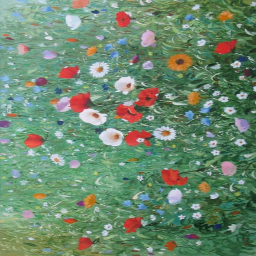

In [12]:
img

In [14]:
content_loss=WaveletContentLoss(content_image=content_image)

In [14]:
content_loss(content_image.unsqueeze(0))

tensor(0., dtype=torch.float64, requires_grad=True)

## Style loss

In [15]:
vgg16 = timm.create_model('vgg16', pretrained=True).to(device).features
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

def calc_features(imgs, target_layers=[1, 6, 11, 18, 25]): 
    x = normalize(imgs)
    feats = []
    for i, layer in enumerate(vgg16[:max(target_layers)+1]):
        x = layer(x)
        if i in target_layers:
            feats.append(x.clone())
    return feats

def calc_features_v2(imgs, use_layers=[1, 6, 11, 18, 25], device='cuda'):
    mean = torch.tensor([0.485, 0.456, 0.406])[:,None,None].to(device)
    std = torch.tensor([0.229, 0.224, 0.225])[:,None,None].to(device)
    x = (imgs-mean) / std
    b, c, h, w = x.shape
    features = [x.reshape(b, c, h*w)] # This reshape is for convenience later
    for i, layer in enumerate(vgg16[:max(use_layers)+1]):
        x = layer(x)
        if i in use_layers:
            b, c, h, w = x.shape
            features.append(x.reshape(b, c, h*w))
    return features

# Batched version of the previous notebook's gram matrix function
def calc_grams(img, target_layers=[1, 6, 11, 18, 25]):
    return L(torch.einsum('bchw, bdhw -> cd', x, x) / (x.shape[-2]*x.shape[-1])
            for x in calc_features(img, target_layers))

class StyleLossToTarget():
    def __init__(self, target_im, target_layers=[1, 6, 11, 18, 25]):
        fc.store_attr()
        with torch.no_grad(): self.target_grams = calc_grams(target_im[None], target_layers)
        
    def __call__(self, input_im): 
        return sum((f1-f2).pow(2).mean() for f1, f2 in 
               zip(calc_grams(input_im, self.target_layers), self.target_grams))
    
#https://wandb.ai/johnowhitaker/style_loss_showdown/reports/An-Explanation-of-Style-Transfer-With-a-Showdown-of-Different-Techniques--VmlldzozMDIzNjg0
#https://github.com/johnowhitaker/tglcourse/blob/main/62_Generators_and_Losses.ipynb

class OTStyleLossToTarget(nn.Module):
    """ Optimal Transport Loss for style comparison, sliced Wasserstein 
    https://openaccess.thecvf.com/content/CVPR2021/papers/Heitz_A_Sliced_Wasserstein_Loss_for_Neural_Texture_Synthesis_CVPR_2021_paper.pdf"""
    def __init__(self, target, size=256, style_layers = [1, 6, 11, 18, 25], scale_factor=1e-5, device='cuda'):
        super(OTStyleLossToTarget, self).__init__()
        if device is None:
            device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
        self.device = device
        self.resize = T.Resize(size)
        self.target = self.resize(target) # resize target image to size
        self.style_layers = style_layers
        self.scale_factor = scale_factor # Defaults tend to be very large, we scale to make them easier to work with
        with torch.no_grad():
            self.target_features = calc_features_v2(self.target, self.style_layers)

    def project_sort(self, x, proj):
        return torch.einsum('bcn,cp->bpn', x, proj).sort()[0]

    def ot_loss(self, source, target, proj_n=32):
        ch, n = source.shape[-2:]
        projs = F.normalize(torch.randn(ch, proj_n).to(self.device), dim=0)
        source_proj = self.project_sort(source, projs)
        target_proj = self.project_sort(target, projs)
        target_interp = F.interpolate(target_proj, n, mode='nearest')
        return (source_proj-target_interp).square().sum()

    def forward(self, inp):
        inp = self.resize(inp) # set size (assumes square images)
        input_features=calc_features_v2(inp, self.style_layers)
        l = 0
        # Run through all features and take l1 loss (mean error) between them
        return sum(self.ot_loss(x, y) for x, y in zip(input_features, self.target_features)) * self.scale_factor


class WassersteinStyleLossToTarget(nn.Module):
    """ Attempting to copy  """
    def __init__(self, target, size=256, style_layers = [1, 6, 11, 18, 25], scale_factor=1e-5, device='cuda'):
        super(WassersteinStyleLossToTarget, self).__init__()
        if device==None:
            device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
        self.resize = T.Resize(size)
        self.target = self.resize(target) # resize target image to size
        self.style_layers = style_layers
        self.scale_factor = scale_factor # Defaults tend to be very large, we scale to make them easier to work with
        with torch.no_grad():
            self.target_features = calc_features_v2(self.target, self.style_layers)

    def calc_2_moments(self, x):
        b, c, n = x.shape
        mu = x.mean(dim=-1, keepdim=True) # b, c, 1
        cov = torch.matmul(x-mu, torch.transpose(x-mu, -1, -2))
        return mu, cov

    def matrix_diag(self, diagonal):
        # Try to copy tf.diag
        N = diagonal.shape[-1]
        shape = diagonal.shape[:-1] + (N, N)
        device, dtype = diagonal.device, diagonal.dtype
        result = torch.zeros(shape, dtype=dtype, device=device)
        indices = torch.arange(result.numel(), device=device).reshape(shape)
        indices = indices.diagonal(dim1=-2, dim2=-1)
        result.view(-1)[indices] = diagonal
        return result

    def l2wass_dist(self, mean_stl, cov_stl, mean_synth, cov_synth):  
        # Calculate tr_cov and root_cov from mean_stl and cov_stl
        eigvals,eigvects = torch.linalg.eigh(cov_stl) # eig returns complex tensors, I think eigh matches tf self_adjoint_eig
        eigroot_mat = self.matrix_diag(torch.sqrt(eigvals.clip(0)))
        root_cov_stl = torch.matmul(torch.matmul(eigvects, eigroot_mat),torch.transpose(eigvects, -1, -2))
        tr_cov_stl = torch.sum(eigvals.clip(0), dim=1, keepdim=True)

        # eigvals_synth,eigvects_synth = torch.linalg.eigh(cov_synth) # Replaced withtorch.linalg.eigvalsh
        tr_cov_synth = torch.sum(torch.linalg.eigvalsh(cov_synth).clip(0), dim=1, keepdim=True)
        mean_diff_squared = torch.mean((mean_synth - mean_stl)**2)
        cov_prod = torch.matmul(torch.matmul(root_cov_stl,cov_synth),root_cov_stl)
        var_overlap = torch.sum(torch.sqrt(torch.linalg.eigvalsh(cov_prod).clip(0.1)), dim=1, keepdim=True) # .clip(0) meant errors getting eigvals 
        dist = mean_diff_squared+tr_cov_stl+tr_cov_synth-2*var_overlap
        return dist

    def forward(self, inp):
        inp = self.resize(inp) # set size (assumes square images)
        input_features = calc_features_v2(inp, self.style_layers) # get features
        l = 0
        for x, y in zip(input_features, self.target_features):
            mean_synth, cov_synth = self.calc_2_moments(x) # input mean and cov
            mean_stl, cov_stl = self.calc_2_moments(y) # target mean and cov
            l += self.l2wass_dist(mean_stl, cov_stl, mean_synth, cov_synth) 
        return l.mean() * self.scale_factor
    

## NeuralCA

In [16]:
filters = torch.stack([
    tensor([[0.0,0.0,0.0],[0.0,1.0,0.0],[0.0,0.0,0.0]]),
    tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]),
    tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]).T,
    tensor([[1.0,2.0,1.0],[2.0,-12,2.0],[1.0,2.0,1.0]])
]).to(device)

# n_channels=8 
def make_grids(n, sz=128, num_channels=8): 
    return torch.zeros(n, num_channels, sz, sz).to(device)

def perchannel_conv(x, filters):
    '''filters: [filter_n, h, w]'''
    b, ch, h, w = x.shape
    y = x.reshape(b*ch, 1, h, w)
    y = F.pad(y, [1, 1, 1, 1], 'circular') # << Note pad mode
    y = F.conv2d(y, filters[:,None])
    return y.reshape(b, -1, h, w)

class NeuralCA(nn.Module):
    def __init__(self, filters, zero_w2=True, hidden_n=64, num_channels_in=8, num_channels_out=8, device='cpu'):
        super().__init__()
        self.filters=filters
        self.device=device
        self.w1 = nn.Conv2d(num_channels_in*4, hidden_n, 1)
        self.chn = num_channels_in
        self.chn_out = num_channels_out
        self.relu = nn.ReLU()
        self.w2 = nn.Conv2d(hidden_n, num_channels_out, 1, bias=False) #TODO
        if zero_w2: self.w2.weight.data.zero_()
        
        self.to(device)

    def forward(self, x, update_rate=0.5):
        y = perchannel_conv(x, self.filters) # Apply the filters
        y = self.w2(self.relu(self.w1(y))) # pass the result through our 'brain'
        b, c, h, w = y.shape
        update_mask = (torch.rand(b, 1, h, w).to(x.device)+update_rate).floor() # Random update
        return x+y*update_mask
    
    def to_rgb(self, x):
        return x[...,:3,:,:]+0.5
    
    def make_video(self, seed_i, n_steps=100):
        x = self.seed(seed_i)
        !mkdir -p steps
        !rm steps/*
        for i in range(n_steps):
            with torch.no_grad():
                x = self(x)
                img = self.to_rgb(x).detach().cpu().clip(0, 1).squeeze().permute(1, 2, 0)
                img = Image.fromarray(np.array(img*255).astype(np.uint8))
                img.save(f'steps/{i:05}.jpeg')
        return progress_video()
    
    def make_video_zoom(self, frame_multip=10, sz=32, upsample_size=512, scale_factor=2, savefile='video.mp4'):
        !rm -r zoomies/
        !mkdir -p zoomies
        zf=1
        scaleup = nn.Upsample(scale_factor=scale_factor)
        preview_scale = nn.Upsample(size=upsample_size, mode='bilinear')
        grid = self.seed(1, sz=sz)
        for i in range(1, 256*frame_multip):
            with torch.no_grad():
                grid = self(grid)
                if i%256 == 0:
                    grid = scaleup(grid)
                if grid.shape[2]>512:
                    grid = grid[:,:,zf:-zf,zf:-zf]

                if i%4==0:
                    img = self.to_rgb(preview_scale(grid)).detach().cpu().clip(0, 1).squeeze().permute(1, 2, 0)
                    Image.fromarray(np.array(img*255).astype(np.uint8)).save(f'zoomies/{i//4:05}.png')

        # Turn the images in steps/ into a video with ffmpeg
        !ffmpeg -y -v 0 -framerate 24 -i zoomies/%05d.png video.mp4

        # Display it inline
        mp4 = open(f'{savefile}','rb').read()
        data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
        return HTML("""
                    <video width=512 controls>
                          <source src="%s" type="video/mp4">
                    </video>
                    """ % data_url)
    
    def make_pic(self, scale_factor=2, sz=16, range_i=950, savefile=None):
        scaleup = nn.Upsample(scale_factor=scale_factor)
        grid = self.seed(1, sz=sz)
        for i in range(1, range_i):
            with torch.no_grad():
                grid = self(grid)
                if i in [300, 600, 700, 750, 800, 850, 900]:
                    grid = scaleup(grid)
        img = self.to_rgb(grid).detach().cpu().clip(0, 1).squeeze().permute(1, 2, 0)
        img = Image.fromarray(np.array(img*255).astype(np.uint8))
        if savefile is not None:
            img.save(savefile)
        return img

    def seed(self, n, sz=128):
        """Initializes n 'grids', size sz. In this case all 0s."""
        # return torch.zeros(n, self.chn, sz, sz).to(self.device)
        return torch.zeros(n, self.chn_out, sz, sz).to(self.device)

In [17]:
class LengthDataset():
    def __init__(self, length=1): self.length=length
    def __len__(self): return self.length
    def __getitem__(self, idx): return 0,0

def get_dummy_dls(length=100):
    return DataLoaders(DataLoader(LengthDataset(length), batch_size=1),
                       DataLoader(LengthDataset(1), batch_size=1))

In [18]:
class NCAProgressCB(ProgressCB):
    def after_batch(self, learn):
        learn.dl.comment = f'{learn.loss:.3f}'
        if not (hasattr(learn, 'metrics') and learn.training): return 
        self.losses.append(learn.loss.item())
        mbar = self.mbar
        if not hasattr(mbar, 'graph_fig'):
            mbar.graph_fig, mbar.graph_axs = plt.subplots(1, 2, figsize=(12, 3.5))
            mbar.graph_out = display(mbar.graph_fig, display_id=True)

        # Update preview image every 64 iters
        if (len(self.losses))%64 != 10: return 
        
        # Plot losses:
        mbar.graph_axs[0].clear()
        mbar.graph_axs[0].plot(self.losses, '.', alpha=0.3)
        mbar.graph_axs[0].set_yscale('log')
        mbar.graph_axs[0].set_ylim(tensor(self.losses).min(), self.losses[0])
        
        # Show preview images:
        rgb = learn.model.to_rgb(learn.preds.detach()).clip(0, 1)#.permute([0, 2, 3, 1])
        show_image(torchvision.utils.make_grid(rgb), ax=mbar.graph_axs[1])
        
        # Update graph
        mbar.graph_out.update(mbar.graph_fig)

In [19]:
class NCACB(TrainCB):
    order = DeviceCB.order+1
    def __init__(self, ca, text_prompt, n_channels=8, style_loss_scale=0.01, clip_loss_scale=3, size=256, 
                 step_n_min=32, step_n_max=96, batch_size=4):
        fc.store_attr()
        with torch.no_grad(): self.pool = make_grids(256, sz=size, num_channels=n_channels) # Set up a 'pool' of grids
    
    def predict(self, learn): 
        # Pick some random samples from the pool
        batch_idx = torch.randint(0, len(self.pool), (self.batch_size,))
        x = self.pool[batch_idx]
        
        # occasionally zero out some samples
        if torch.randint(8, (1,)) < 1: 
            x[:1] =  make_grids(1, sz=self.size)
        
        # Apply the model a number of times
        for _ in range(torch.randint(self.step_n_min, self.step_n_max, (1,))):
            x = learn.model(x)
        
        # Update pool
        with torch.no_grad(): self.pool[batch_idx] = x
        
        # and store preds
        learn.preds = x
        
    def get_loss(self, learn): 
        imgs=learn.model.to_rgb(self.learn.preds)
        style_loss = learn.loss_func(imgs)
        overflow_loss = (learn.preds-learn.preds.clamp(-1.0, 1.0)).abs().sum()
        clip_loss= self.clip_loss_scale*self.text_prompt(imgs)
        learn.loss = overflow_loss + style_loss*self.style_loss_scale +clip_loss
        
    def backward(self, learn):
        learn.loss.backward()
        # Gradient normalization:
        for p in learn.model.parameters():
            p.grad /= (p.grad.norm()+1e-8) 
        
    def before_fit(self, learn): self.learn=learn 

In [20]:
class BaseSchedCB(Callback):
    def __init__(self, sched): 
        self.sched = sched
        
    def before_fit(self, learn): 
        self.schedo = self.sched(learn.opt)
        
    def step_(self, learn):
        if learn.training: 
            self.schedo.step()
        
class BatchSchedCB(BaseSchedCB):
    def after_batch(self, learn):
        self.step_(learn) 

## Training setting

In [21]:
#class to easily combine different filters
class Filters:
    def __init__(self, device='cuda'):
        self.device=device
        self.identity=tensor([[0.0,0.0,0.0],[0.0,1.0,0.0],[0.0,0.0,0.0]]).to(device)
        self.laplace=tensor([[1.0,2.0,1.0],[2.0,-12,2.0],[1.0,2.0,1.0]]).to(device)
        
        self.filters={'sobel': torch.stack([
            tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]),
            tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]).T,
        ]).to(device),
                      'scharr':torch.stack([
           tensor([ [-3, 0, 3], [-10, 0, 10], [-3, 0, 3]]),
           tensor([[-3, -10, -3], [0, 0, 0], [3, 10, 3]]),
        ]).to(device),
                      'pewitt':torch.stack([
           tensor([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]),
           tensor([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]),
        ]).to(device)}
        
    def __call__(self, filter_name):
        if isinstance(filter_name, str):
            return torch.cat((self.identity.unsqueeze(0), self.filters[filter_name], self.laplace.unsqueeze(0)), dim=0)
        if isinstance(filter_name,  (list, tuple)):
            for i, single_filter in enumerate(filter_name):
                if i==0:
                    filter_combined=torch.cat((self.identity.unsqueeze(0), self.filters[single_filter]), dim=0)
                else:
                    filter_combined=torch.cat((filter_combined, self.filters[single_filter]), dim=0)
            filter_combined=torch.cat((filter_combined, self.laplace.unsqueeze(0)), dim=0)
            return filter_combined
        

In [22]:
filters=Filters()
filters('sobel')

tensor([[[  0.,   0.,   0.],
         [  0.,   1.,   0.],
         [  0.,   0.,   0.]],

        [[ -1.,   0.,   1.],
         [ -2.,   0.,   2.],
         [ -1.,   0.,   1.]],

        [[ -1.,  -2.,  -1.],
         [  0.,   0.,   0.],
         [  1.,   2.,   1.]],

        [[  1.,   2.,   1.],
         [  2., -12.,   2.],
         [  1.,   2.,   1.]]], device='cuda:0')

In [23]:
filters(['sobel', 'scharr'])

tensor([[[  0.,   0.,   0.],
         [  0.,   1.,   0.],
         [  0.,   0.,   0.]],

        [[ -1.,   0.,   1.],
         [ -2.,   0.,   2.],
         [ -1.,   0.,   1.]],

        [[ -1.,  -2.,  -1.],
         [  0.,   0.,   0.],
         [  1.,   2.,   1.]],

        [[ -3.,   0.,   3.],
         [-10.,   0.,  10.],
         [ -3.,   0.,   3.]],

        [[ -3., -10.,  -3.],
         [  0.,   0.,   0.],
         [  3.,  10.,   3.]],

        [[  1.,   2.,   1.],
         [  2., -12.,   2.],
         [  1.,   2.,   1.]]], device='cuda:0')

#### Image

In [25]:
#style_url = "https://www.artmajeur.com/medias/standard/l/a/laff/artwork/11425511_img-20180825-160133.jpg"
#style_url= 'style_images/estonian.jpg'
#style_url= 'style_images/monarch.png'
#style_url= 'style_images/aasalilled.jpg'
# style_url= 'style_images/voililled.jpg'
style_url= 'style_images/what-kind-of-art-is-popular-right-now.jpg'
#style_url= 'style_images/eesti_voo.png'
style_img = imread(style_url, max_size=256).to(device)
#style_loss=StyleLossToTarget(style_img)#.to(device)
#style_loss=OTStyleLossToTarget(style_img.unsqueeze(0))
style_loss=WassersteinStyleLossToTarget(style_img.unsqueeze(0))

In [28]:
len(style_loss.target_features)

6

In [26]:
style_img.shape

torch.Size([3, 256, 158])

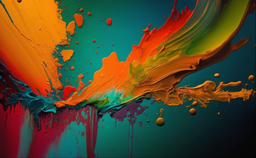

In [27]:
im_np=imread(style_url, max_size=256, to_tensor=False)
Image.fromarray(np.array(im_np*255).astype(np.uint8))

In [28]:
im_np.shape

(158, 256, 3)

## if using content loss image - experimental

In [29]:
class ContentLossToTarget(nn.Module):
    def __init__(self, target_im, target_layers=[22]):
        super(ContentLossToTarget, self).__init__()
        fc.store_attr()
        with torch.no_grad(): self.target_grams = calc_grams(target_im[None], target_layers)
        
    def forward(self, input_im): 
        loss= sum((f1-f2).pow(2).mean() for f1, f2 in 
               zip(calc_grams(input_im, self.target_layers), self.target_grams))
        #print(loss)
        return loss
    
    
class ContentLossMSE(nn.Module):
    def __init__(self, target_im):
        super(ContentLossMSE, self).__init__()
        fc.store_attr()
        self.target_im=target_im.detach()

    def forward(self, inp):
        loss = F.mse_loss(inp, self.target_im)
        return loss

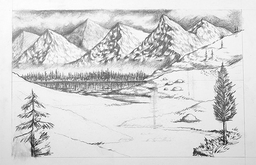

In [30]:
#content_image_url='content_images/bw.jpg'
content_image_url='content_images/landscape.jpg'
content_image_url='content_images/landscape-drawing-25.jpg'
content_image=imread(content_image_url, max_size=256).to(device)
content_image=T.Resize(size=[256,256])(content_image)
# content_loss=WassersteinStyleLossToTarget(content_image.unsqueeze(0), style_layers=[29], scale_factor=1)

#content_loss_gram=StyleLossToTarget(content_image, target_layers=[22])
content_loss_gram=ContentLossToTarget(content_image, target_layers=[22, 29])

content_loss_mse=ContentLossMSE(content_image.unsqueeze(0))

im_np=imread(content_image_url, max_size=256, to_tensor=False)
Image.fromarray(np.array(im_np*255).astype(np.uint8))

In [31]:
content_image.shape

torch.Size([3, 256, 256])

In [32]:
content_loss_gram(content_image.unsqueeze(0)+1.11)

tensor(0.8910, device='cuda:0', grad_fn=<AddBackward0>)

In [33]:
content_loss_gram.target_grams[0].shape

torch.Size([512, 512])

#### Prompt

In [34]:
#prompt
# text = 'Stained glass window' #@param
#text = 'rocky montain' #@param
#text = 'cat' #@param
#text = 'pile of snakes' #@param
#text = 'flowers in the field' #@param
#text = 'snails' #@param
#text = 'bricks' #@param
#text = 'spider web' #@param
#text = 'furry' #@param
# text = 'a pile of rocks' #@param
# text = 'water drops' #@param
#text = 'saw tooth' #@param
#text = 'ant colony' #@param
# text = 'stormy sea drama, higgh quality' #@param
# text = 'beehive' #@param
# text = 'tiger stripes' #@param
# text = 'lava running from volcano' #@param
# text = 'earth' #@param
# text = 'explosion' #@param
text = 'cracks in the glass' #@param
# text = 'sand grains under microscope' #@param
# text = 'rocky montain, high quality, 8k'
# text = 'volcano eruption, magma, high quality, 8k'
text_prompt = TextPrompt(text)

In [35]:
#model = NeuralCA(device=device)
filters=Filters()
#If you stack more filters on top of each other, change channels num
# model = NeuralCA(num_channels_in=8, num_channels_out=8, device=device)
# model = NeuralCA(filters(['scharr']), num_channels_in=8, num_channels_out=8, device=device)
#model = NeuralCA(filters(['sobel', 'scharr']), num_channels_in=12, num_channels_out=8, device=device)
model = NeuralCA(filters(['sobel']), num_channels_in=8, num_channels_out=8, device=device)
# model = NeuralCA(num_channels_in=16, num_channels_out=8, device=device)
opt_func=torch.optim.Adam
# lr_sched_func = partial(torch.optim.lr_scheduler.MultiStepLR, milestones=[2000], gamma=0.3)
lr_sched_func = partial(torch.optim.lr_scheduler.MultiStepLR, milestones=[300, 400], gamma=0.3)
#cbs = [NCACB(model, text_prompt=text_prompt), BatchSchedCB(lr_sched_func), NCAProgressCB(), MetricsCB()]

#use content loss instead of text prompt
cbs = [NCACB(model, text_prompt=content_loss_mse, clip_loss_scale=1.0, style_loss_scale=0.4), 
       BatchSchedCB(lr_sched_func), NCAProgressCB(), MetricsCB()]

# learn = Learner(model, get_dummy_dls(1000), style_loss, lr=1e-3, cbs=cbs, opt_func=opt_func)
learn = Learner(model, get_dummy_dls(500), style_loss, lr=1e-3, cbs=cbs, opt_func=opt_func)

loss,epoch,train
17827.301,0,train
24.514,0,eval


/tmp/ipykernel_1596163/483748452.py:21: UserWarning: Using a target size (torch.Size([1, 3, 256, 256])) that is different to the input size (torch.Size([4, 3, 256, 256])). This will likely lead to incorrect results due to broadcasting. Please ensure they have the same size.
  loss = F.mse_loss(inp, self.target_im)


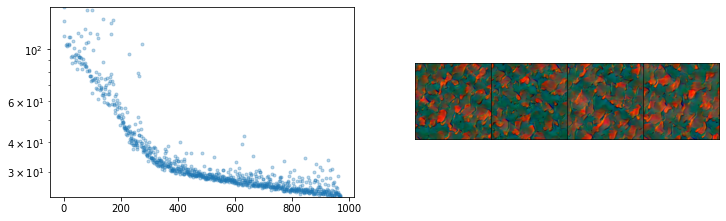

In [36]:
learn.fit(1)

In [37]:
model

NeuralCA(
  (w1): Conv2d(32, 64, kernel_size=(1, 1), stride=(1, 1))
  (relu): ReLU()
  (w2): Conv2d(64, 8, kernel_size=(1, 1), stride=(1, 1), bias=False)
)

In [38]:
learn.model.make_video(1,n_steps=200)

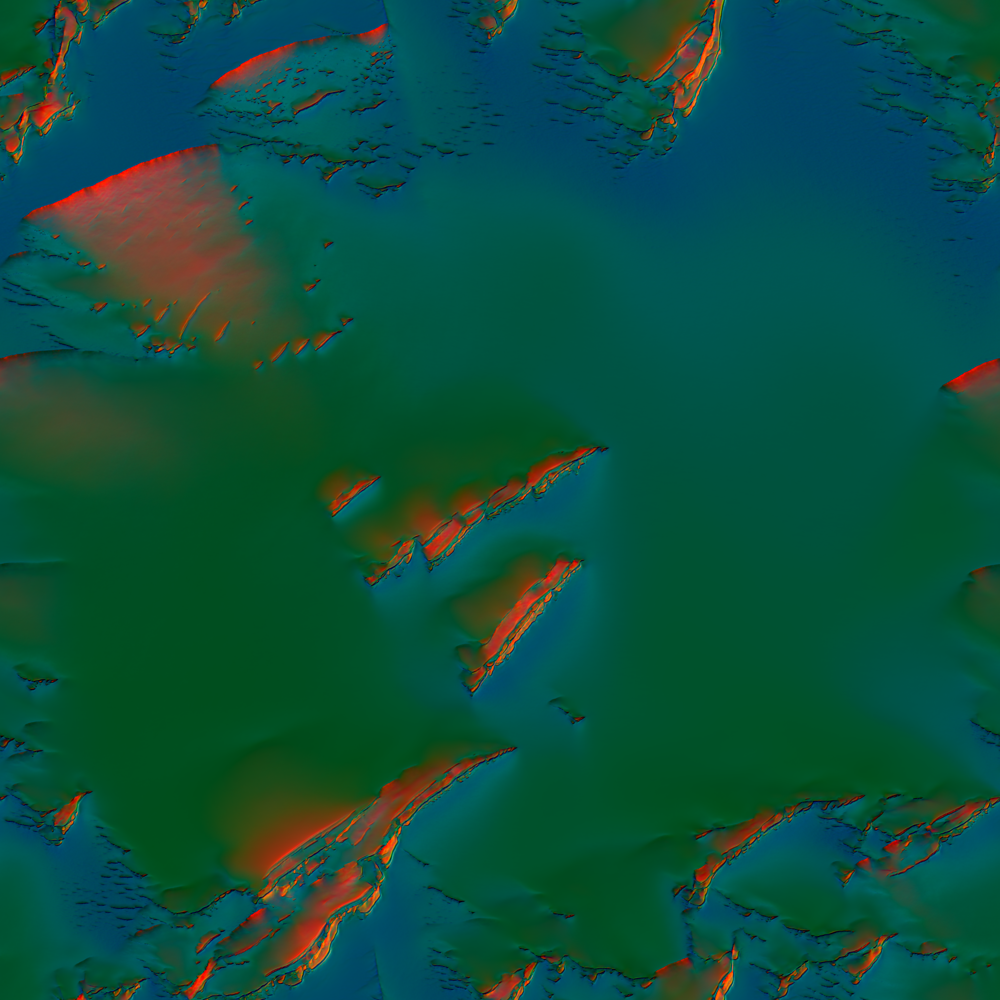

In [39]:
learn.model.make_pic(savefile=f'output_images/{text.replace(" ","_")}_{style_url.split("/")[-1].replace(".","_")}_.png', sz=32)

In [40]:
learn.model.make_video_zoom()

## Model size

In [41]:
#number or params in model
sum(p.numel() for p in learn.model.parameters()) # !!

2624

## visualize different filters

In [42]:
filters_sobel = torch.stack([
    tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]),
    tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]).T,
]).to(device)

filters_scharr = torch.stack([
   tensor([ [-3, 0, 3], [-10, 0, 10], [-3, 0, 3]]),
   tensor([[-3, -10, -3], [0, 0, 0], [3, 10, 3]]),
]).to(device, dtype=torch.float32)

filters_pewitt = torch.stack([
      tensor([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]),
   tensor([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]),
]).to(device, dtype=torch.float32)

filters_combined = torch.stack([
    tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]),
   tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]).T,
        tensor([ [-3, 0, 3], [-10, 0, 10], [-3, 0, 3]]),
    tensor([[-3, -10, -3], [0, 0, 0], [3, 10, 3]]),
      tensor([[-1, 0, 1], [-1, 0, 1], [-1, 0, 1]]),
   tensor([[-1, -1, -1], [0, 0, 0], [1, 1, 1]]),
]).to(device)

filters_sobelscharr = torch.stack([
    tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]),
    tensor([[-1.0,0.0,1.0],[-2.0,0.0,2.0],[-1.0,0.0,1.0]]).T,
       tensor([ [-3, 0, 3], [-10, 0, 10], [-3, 0, 3]]),
   tensor([[-3, -10, -3], [0, 0, 0], [3, 10, 3]]),
]).to(device)


In [43]:
def perchannel_conv(x, filters):
    '''filters: [filter_n, h, w]'''
    b, ch, h, w = x.shape
    y = x.reshape(b*ch, 1, h, w)
    y = F.pad(y, [1, 1, 1, 1], 'circular') # << Note pad mode
    y = F.conv2d(y, filters[:,None])
    return y.reshape(b, -1, h, w)

def apply_filter2img(style_img, filters, convert2grayscale=True):
    img_filtered=perchannel_conv(style_img.unsqueeze(0), filters)
    img_filtered = model.to_rgb(img_filtered).detach().cpu().clip(0, 1).squeeze().permute(2, 1, 0)
    img = Image.fromarray(np.array(img_filtered*255).astype(np.uint8))
    if convert2grayscale:
        img=img.convert('L')
    return img

<AxesSubplot:>

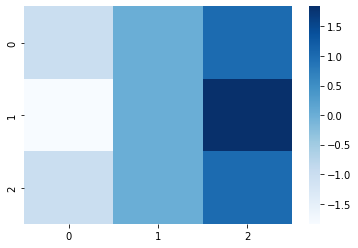

In [44]:
sns.heatmap(filters_sobel[0].cpu(),robust=True, cmap="Blues")

<AxesSubplot:>

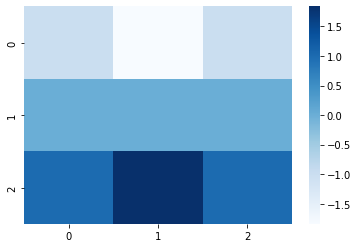

In [45]:
sns.heatmap(filters_sobel[1].cpu(),robust=True, cmap="Blues")

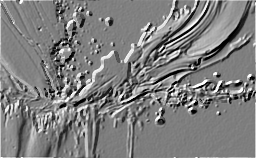

In [46]:
apply_filter2img(style_img, filters_sobel)

<AxesSubplot:>

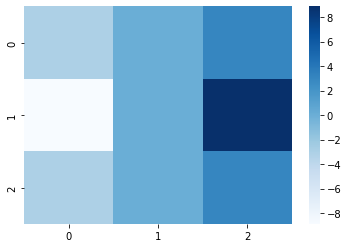

In [47]:
sns.heatmap(filters_scharr[0].cpu(),robust=True, cmap="Blues")

<AxesSubplot:>

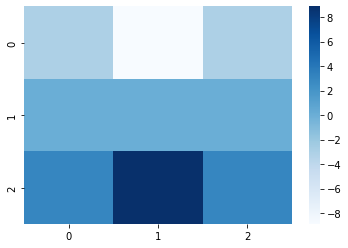

In [48]:
sns.heatmap(filters_scharr[1].cpu(),robust=True, cmap="Blues")

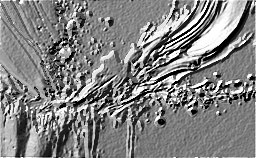

In [49]:
apply_filter2img(style_img, filters_scharr)

<AxesSubplot:>

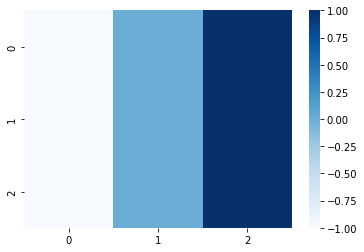

In [50]:
sns.heatmap(filters_pewitt[0].cpu(),robust=True, cmap="Blues")

<AxesSubplot:>

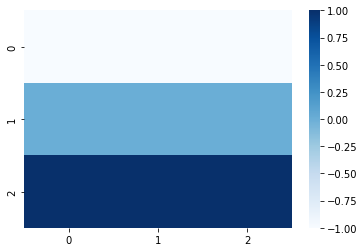

In [51]:
sns.heatmap(filters_pewitt[1].cpu(),robust=True, cmap="Blues")

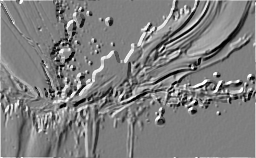

In [52]:
apply_filter2img(style_img, filters_pewitt)

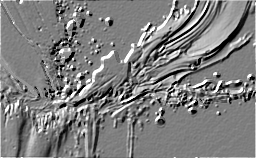

In [53]:
apply_filter2img(style_img, filters_combined)

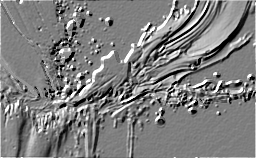

In [54]:
apply_filter2img(style_img, filters_sobelscharr)

In [55]:
filters_sobel.shape

torch.Size([2, 3, 3])

## Analyze wasserstein loss

In [56]:
class WassersteinStyleLossToTargetExplain(nn.Module):
    """ saves more internal stuff for later analysis """
    def __init__(self, target, size=256, style_layers = [1, 6, 11, 18, 25], scale_factor=1e-5, device='cuda'):
        super(WassersteinStyleLossToTargetExplain, self).__init__()
        if device==None:
            device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
        self.resize = T.Resize(size)
        self.target = self.resize(target) # resize target image to size
        self.style_layers = style_layers
        self.scale_factor = scale_factor # Defaults tend to be very large, we scale to make them easier to work with
        with torch.no_grad():
            self.target_features = calc_features_v2(self.target, self.style_layers)

    def calc_2_moments(self, x):
        b, c, n = x.shape
        mu = x.mean(dim=-1, keepdim=True) # b, c, 1
        cov = torch.matmul(x-mu, torch.transpose(x-mu, -1, -2))
        return mu, cov

    def matrix_diag(self, diagonal):
        # Try to copy tf.diag
        N = diagonal.shape[-1]
        shape = diagonal.shape[:-1] + (N, N)
        device, dtype = diagonal.device, diagonal.dtype
        result = torch.zeros(shape, dtype=dtype, device=device)
        indices = torch.arange(result.numel(), device=device).reshape(shape)
        indices = indices.diagonal(dim1=-2, dim2=-1)
        result.view(-1)[indices] = diagonal
        return result

    def l2wass_dist(self, mean_stl, cov_stl, mean_synth, cov_synth):  
        # Calculate tr_cov and root_cov from mean_stl and cov_stl
        self.eigvals,self.eigvects = torch.linalg.eigh(cov_stl) # eig returns complex tensors, I think eigh matches tf self_adjoint_eig
        self.eigroot_mat = self.matrix_diag(torch.sqrt(self.eigvals.clip(0)))
        self.root_cov_stl = torch.matmul(torch.matmul(self.eigvects, self.eigroot_mat),torch.transpose(self.eigvects, -1, -2))
        self.tr_cov_stl = torch.sum(self.eigvals.clip(0), dim=1, keepdim=True)

        # eigvals_synth,eigvects_synth = torch.linalg.eigh(cov_synth) # Replaced withtorch.linalg.eigvalsh
        self.tr_cov_synth = torch.sum(torch.linalg.eigvalsh(self.cov_synth).clip(0), dim=1, keepdim=True)
        self.mean_diff_squared = torch.mean((self.mean_synth - self.mean_stl)**2)
        self.cov_prod = torch.matmul(torch.matmul(self.root_cov_stl,self.cov_synth),self.root_cov_stl)
        self.var_overlap = torch.sum(torch.sqrt(torch.linalg.eigvalsh(self.cov_prod).clip(0.1)), dim=1, keepdim=True) # .clip(0) meant errors getting eigvals 
        dist = self.mean_diff_squared+self.tr_cov_stl+self.tr_cov_synth-2*self.var_overlap
        return dist

    def forward(self, inp):
        inp = self.resize(inp) # set size (assumes square images)
        self.input_features = calc_features_v2(inp, self.style_layers) # get features
        l = 0
        for x, y in zip(self.input_features, self.target_features):
            self.mean_synth, self.cov_synth = self.calc_2_moments(x) # input mean and cov
            self.mean_stl, self.cov_stl = self.calc_2_moments(y) # target mean and cov
            l += self.l2wass_dist(self.mean_stl, self.cov_stl, self.mean_synth, self.cov_synth) 
        return l.mean() * self.scale_factor

In [57]:
wars_loss=WassersteinStyleLossToTargetExplain(target=style_img.unsqueeze(0))

In [58]:
wars_loss

WassersteinStyleLossToTargetExplain(
  (resize): Resize(size=256, interpolation=bilinear, max_size=None, antialias=None)
)

In [59]:
len(wars_loss.target_features)

6

In [60]:
wars_loss.target_features[0].shape

torch.Size([1, 3, 105984])

In [61]:
batch_idx = torch.randint(0, len(cbs[0].pool), (cbs[0].batch_size,))
x = cbs[0].pool[batch_idx]
batch_idx

tensor([215, 178,  89, 111])

In [62]:
x.shape

torch.Size([4, 8, 256, 256])

In [63]:
if torch.randint(8, (1,)) < 1: 
    x[:1] =  make_grids(1, sz=cbs[0].size)

In [64]:
for _ in range(50):
    x = learn.model(x)

In [65]:
x.shape

torch.Size([4, 8, 256, 256])

In [66]:
#model generated images
# imgs=learn.model.to_rgb(cbs[0].learn.preds)
imgs=learn.model.to_rgb(x)

In [67]:
imgs.shape

torch.Size([4, 3, 256, 256])

In [68]:
w=256
h=256
grid_ = torch.rand(1, 1, w, h) # bs, channels, w, h
im_array = np.array(grid_[0][0].clip(0, 1))

In [69]:
exp_frac=0
grid=imgs
im_array = exp_frac*im_array + (1-exp_frac)*np.array(grid.cpu().detach().numpy()[0][0].clip(0, 1))
im = Image.fromarray(np.uint8(cm.gist_earth(im_array)*255)).convert('RGB')

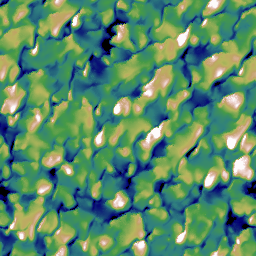

In [70]:
im

In [71]:
wars_loss(imgs)

tensor(62.3049, device='cuda:0', grad_fn=<MulBackward0>)

In [72]:
wars_loss

WassersteinStyleLossToTargetExplain(
  (resize): Resize(size=256, interpolation=bilinear, max_size=None, antialias=None)
)

In [73]:
wars_loss.mean_synth.shape

torch.Size([4, 512, 1])

In [74]:
wars_loss.cov_synth.shape

torch.Size([4, 512, 512])

In [75]:
wars_loss.mean_stl.shape

torch.Size([1, 512, 1])

In [76]:
wars_loss.cov_stl.shape

torch.Size([1, 512, 512])

In [77]:
wars_loss.eigvals.shape

torch.Size([1, 512])

In [78]:
wars_loss.eigvects.shape

torch.Size([1, 512, 512])

In [79]:
wars_loss.eigroot_mat.shape

torch.Size([1, 512, 512])

In [80]:
wars_loss.eigvals.clip(0).cpu().shape

torch.Size([1, 512])

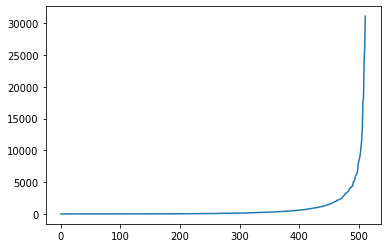

In [81]:
plt.plot(wars_loss.eigvals.clip(0).cpu()[0])

In [82]:
wars_loss.root_cov_stl.shape

torch.Size([1, 512, 512])

<AxesSubplot:>

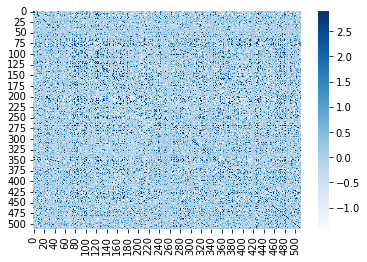

In [83]:
sns.heatmap(wars_loss.root_cov_stl[0].cpu(), robust=True, cmap="Blues")

In [84]:
wars_loss.tr_cov_stl

tensor([[437240.5625]], device='cuda:0')

In [85]:
wars_loss.tr_cov_synth

tensor([[232945.4062],
        [319634.7188],
        [256665.7188],
        [288352.4375]], device='cuda:0', grad_fn=<SumBackward1>)

In [86]:
wars_loss.mean_diff_squared 

tensor(0.5008, device='cuda:0', grad_fn=<MeanBackward0>)

In [87]:
wars_loss.cov_prod.shape

torch.Size([4, 512, 512])

<AxesSubplot:>

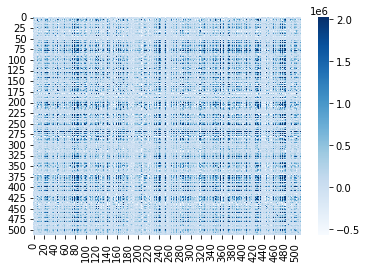

In [88]:
sns.heatmap(wars_loss.cov_prod[0].cpu().detach().numpy(), robust=True, cmap="Blues")

In [89]:
wars_loss.var_overlap

tensor([[184522.8906],
        [230046.7188],
        [199675.4219],
        [218979.1250]], device='cuda:0', grad_fn=<SumBackward1>)

In [90]:
wars_loss.input_features[0].mean(dim=-1, keepdim=True).shape

torch.Size([4, 3, 1])

In [91]:
# wars_loss.target_features[0]
wars_loss.target_features[0].mean(dim=-1, keepdim=True).shape

torch.Size([1, 3, 1])

In [92]:
(wars_loss.input_features[0].mean(dim=-1, keepdim=True)-wars_loss.target_features[0].mean(dim=-1, keepdim=True)).shape

torch.Size([4, 3, 1])

In [93]:
wars_loss.input_features[0].shape

torch.Size([4, 3, 65536])

In [94]:
wars_loss.input_features[0][0].shape

torch.Size([3, 65536])

In [95]:
## compare input and target features histograms

(array([4.000e+00, 5.000e+00, 3.800e+01, 1.150e+02, 2.010e+02, 3.310e+02,
        5.330e+02, 1.022e+03, 1.388e+03, 1.669e+03, 1.958e+03, 2.358e+03,
        2.914e+03, 3.406e+03, 3.706e+03, 3.629e+03, 3.955e+03, 3.994e+03,
        3.655e+03, 3.497e+03, 3.334e+03, 3.086e+03, 2.859e+03, 2.691e+03,
        2.316e+03, 2.143e+03, 1.949e+03, 1.739e+03, 1.403e+03, 1.202e+03,
        1.017e+03, 7.820e+02, 6.290e+02, 5.440e+02, 4.460e+02, 2.740e+02,
        2.150e+02, 1.720e+02, 1.010e+02, 7.900e+01, 5.100e+01, 4.100e+01,
        2.900e+01, 1.600e+01, 1.500e+01, 1.100e+01, 6.000e+00, 3.000e+00,
        2.000e+00, 3.000e+00]),
 array([-2.9213192 , -2.7780466 , -2.6347737 , -2.4915009 , -2.3482282 ,
        -2.2049556 , -2.0616827 , -1.91841   , -1.7751372 , -1.6318644 ,
        -1.4885917 , -1.3453189 , -1.2020462 , -1.0587734 , -0.91550064,
        -0.7722279 , -0.6289551 , -0.48568237, -0.3424096 , -0.19913685,
        -0.0558641 ,  0.08740866,  0.23068142,  0.37395418,  0.51722693,
         0.

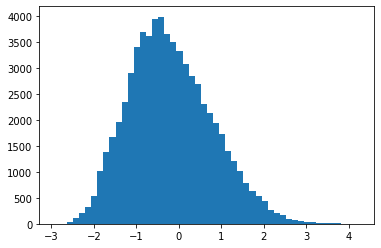

In [96]:
plt.hist(wars_loss.input_features[0][0][0].cpu().detach().numpy(), bins=50)

(array([6.1100e+02, 6.9910e+03, 1.1007e+04, 8.8910e+03, 6.1840e+03,
        4.5070e+03, 4.0430e+03, 3.2930e+03, 2.8010e+03, 3.0050e+03,
        2.8130e+03, 2.6390e+03, 2.5890e+03, 2.5340e+03, 2.5260e+03,
        2.5280e+03, 2.4200e+03, 2.5990e+03, 2.6870e+03, 2.4650e+03,
        2.5390e+03, 2.0540e+03, 1.9100e+03, 1.7060e+03, 1.6670e+03,
        1.5790e+03, 1.6910e+03, 1.6790e+03, 1.3320e+03, 1.2950e+03,
        1.1510e+03, 1.0120e+03, 9.9000e+02, 1.1720e+03, 1.0410e+03,
        1.0770e+03, 1.0970e+03, 9.9400e+02, 8.2200e+02, 6.7200e+02,
        5.7200e+02, 4.8400e+02, 1.1700e+02, 3.2000e+01, 4.2000e+01,
        5.5000e+01, 4.0000e+01, 1.7000e+01, 8.0000e+00, 4.0000e+00]),
 array([-1.8003447 , -1.7444072 , -1.6884696 , -1.6325321 , -1.5765946 ,
        -1.5206571 , -1.4647195 , -1.4087821 , -1.3528446 , -1.2969071 ,
        -1.2409695 , -1.185032  , -1.1290945 , -1.073157  , -1.0172194 ,
        -0.9612819 , -0.9053444 , -0.8494069 , -0.79346937, -0.73753184,
        -0.6815943 , -0.62

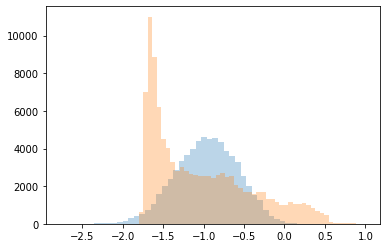

In [97]:
plt.hist(wars_loss.input_features[0][0][2].cpu().detach().numpy(), bins=50, alpha=0.3)
plt.hist(wars_loss.target_features[0][0][2].cpu().detach().numpy(), bins=50,alpha=0.3)

In [98]:
 def l2wass_dist(self, mean_stl, cov_stl, mean_synth, cov_synth):  
        # Calculate tr_cov and root_cov from mean_stl and cov_stl
        self.eigvals,self.eigvects = torch.linalg.eigh(cov_stl) # eig returns complex tensors, I think eigh matches tf self_adjoint_eig
        self.eigroot_mat = self.matrix_diag(torch.sqrt(self.eigvals.clip(0)))
        self.root_cov_stl = torch.matmul(torch.matmul(self.eigvects, self.eigroot_mat),torch.transpose(self.eigvects, -1, -2))
        self.tr_cov_stl = torch.sum(self.eigvals.clip(0), dim=1, keepdim=True)

        # eigvals_synth,eigvects_synth = torch.linalg.eigh(cov_synth) # Replaced withtorch.linalg.eigvalsh
        self.tr_cov_synth = torch.sum(torch.linalg.eigvalsh(self.cov_synth).clip(0), dim=1, keepdim=True)
        self.mean_diff_squared = torch.mean((self.mean_synth - self.mean_stl)**2)
        self.cov_prod = torch.matmul(torch.matmul(self.root_cov_stl,self.cov_synth),self.root_cov_stl)
        self.var_overlap = torch.sum(torch.sqrt(torch.linalg.eigvalsh(self.cov_prod).clip(0.1)), dim=1, keepdim=True) # .clip(0) meant errors getting eigvals 
        dist = self.mean_diff_squared+self.tr_cov_stl+self.tr_cov_synth-2*self.var_overlap
        return dist

In [99]:
wars_loss2=WassersteinStyleLossToTargetExplain(target=style_img.unsqueeze(0))

In [100]:
x.shape

torch.Size([4, 8, 256, 256])

In [101]:
style_img.unsqueeze(0).shape

torch.Size([1, 3, 256, 158])

In [102]:
wars_loss2(style_img.unsqueeze(0))

tensor(-0.0870, device='cuda:0', grad_fn=<MulBackward0>)

In [103]:
wars_loss2(style_img.unsqueeze(0)+0.5)

tensor(22.3496, device='cuda:0', grad_fn=<MulBackward0>)

In [104]:
wars_loss2(style_img.unsqueeze(0)+0.1)

tensor(2.4861, device='cuda:0', grad_fn=<MulBackward0>)

In [105]:
wars_loss2(style_img.unsqueeze(0)+0.8)

tensor(63.5948, device='cuda:0', grad_fn=<MulBackward0>)